In [1]:
import torch # import libraries
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim
import cv2
import requests

import matplotlib.pyplot as plt
import numpy as np
import gc

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [3]:
# read the classes names of the imagenet
with open("/kaggle/working/imagenet_classes.json", 'w') as f_:
    f_.write(requests.get("https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json").text)

In [4]:
import json

with open('imagenet_classes.json') as f:
    class_names = json.load(f)

In [5]:
!ls /kaggle/input/imagenetmini-1000/imagenet-mini

train  val


In [6]:
DS_DIR = "/kaggle/input/imagenetmini-1000/imagenet-mini"

### Data processing

In [7]:
mean = torch.tensor([0.485, 0.456, 0.406]) # imagenet mean and std
std = torch.tensor([0.229, 0.224, 0.225])

data_transforms = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

image_datasets = {
    'train': 
    torchvision.datasets.ImageFolder(DS_DIR + '/train', data_transforms),
    'validation': 
    torchvision.datasets.ImageFolder(DS_DIR + '/val', data_transforms)
}

dataloaders = {
    'train':
    torch.utils.data.DataLoader(image_datasets['train'],
                                batch_size=64,
                                shuffle=True,
                                num_workers=0),  # for Kaggle
    'validation':
    torch.utils.data.DataLoader(image_datasets['validation'],
                                batch_size=64,
                                shuffle=True,
                                num_workers=0)  # for Kaggle
}

Take the resnet50 with pretrained imagenet weights for visualizing the class activation maps and interpreting what it had learned.

In [8]:
resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2).to(device)
resnet.eval()

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 55.9MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Visualization of CAMs

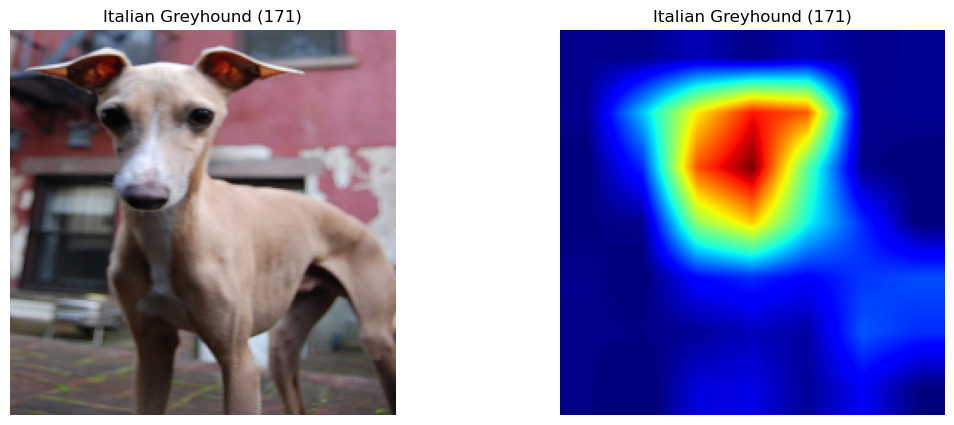

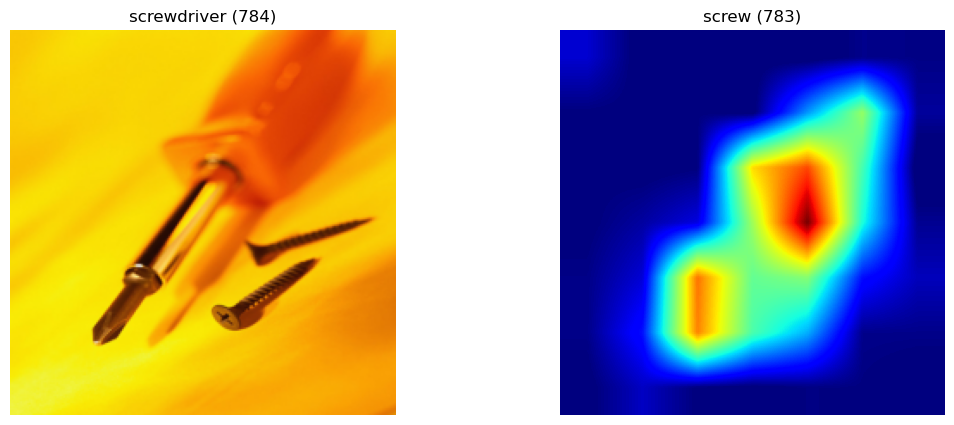

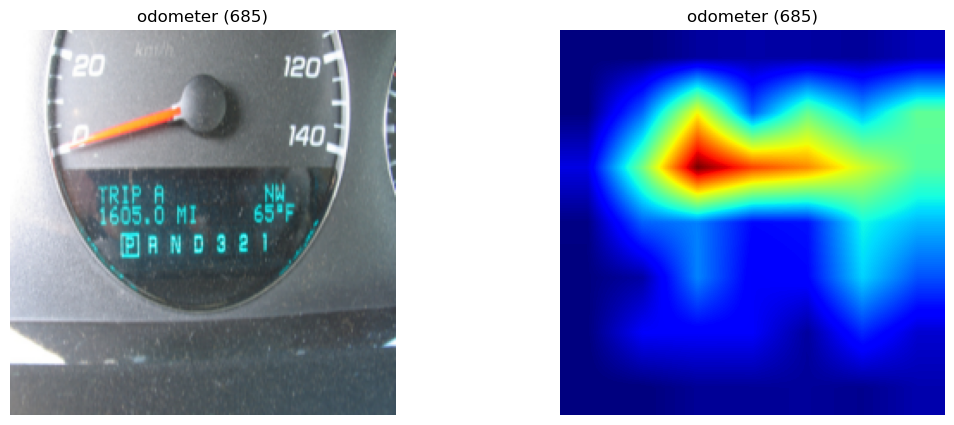

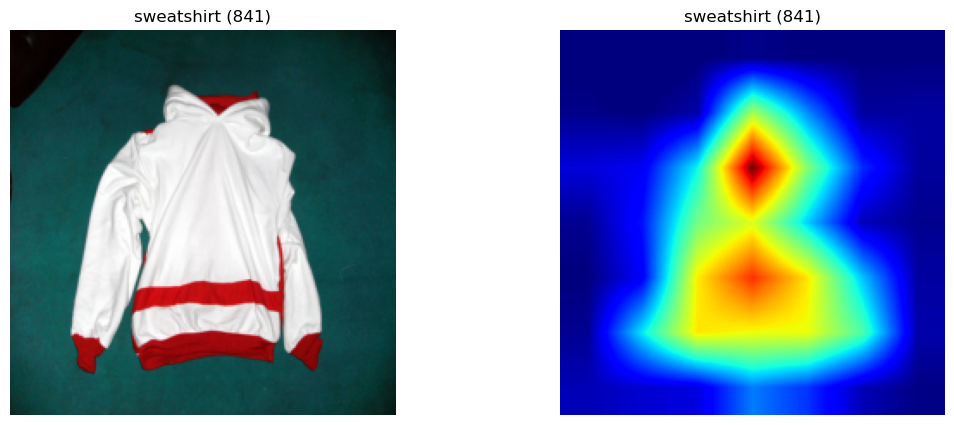

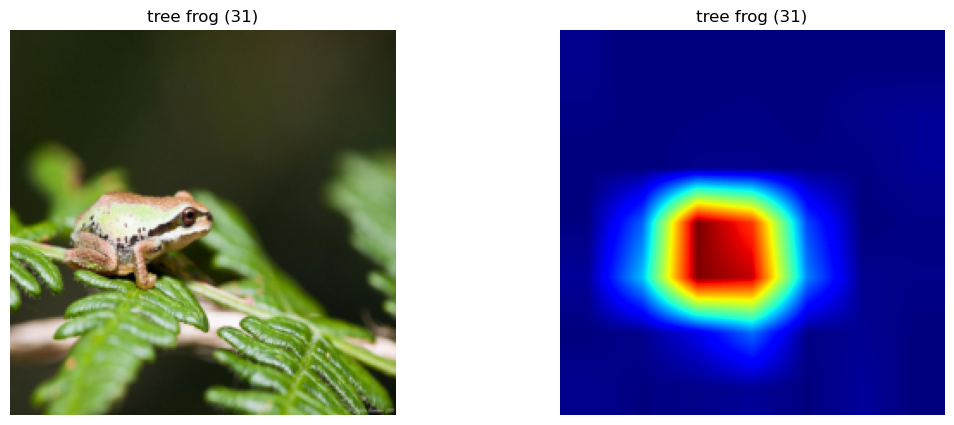

...

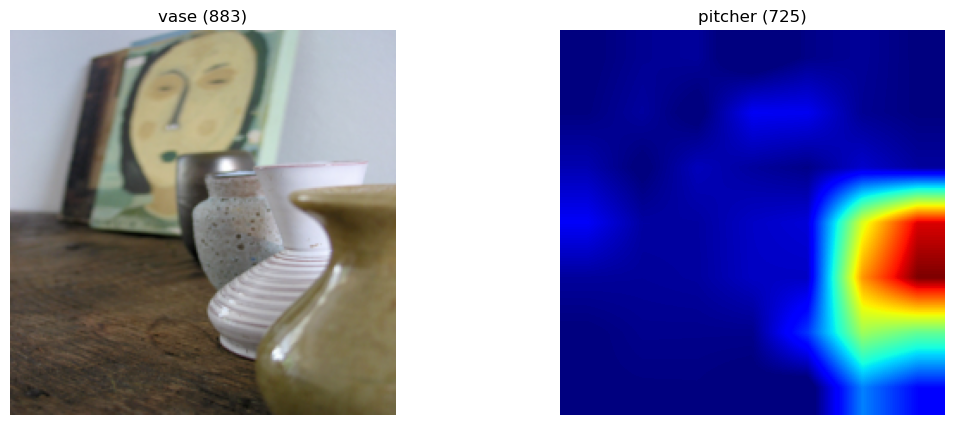

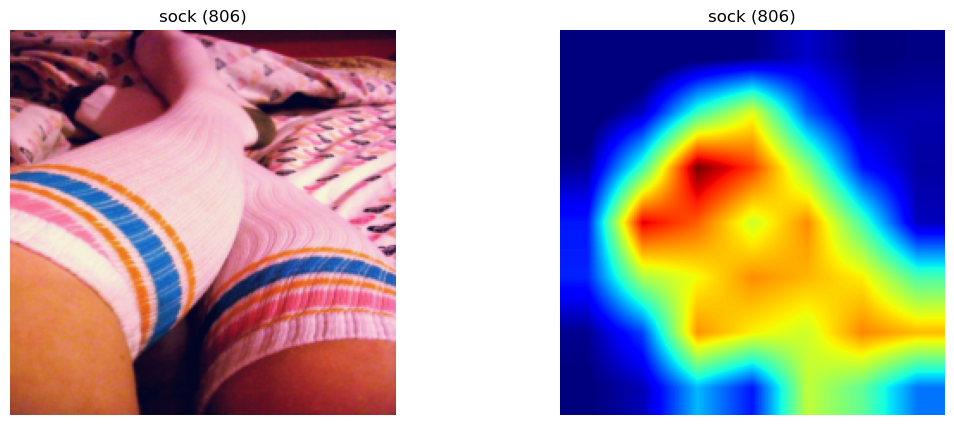

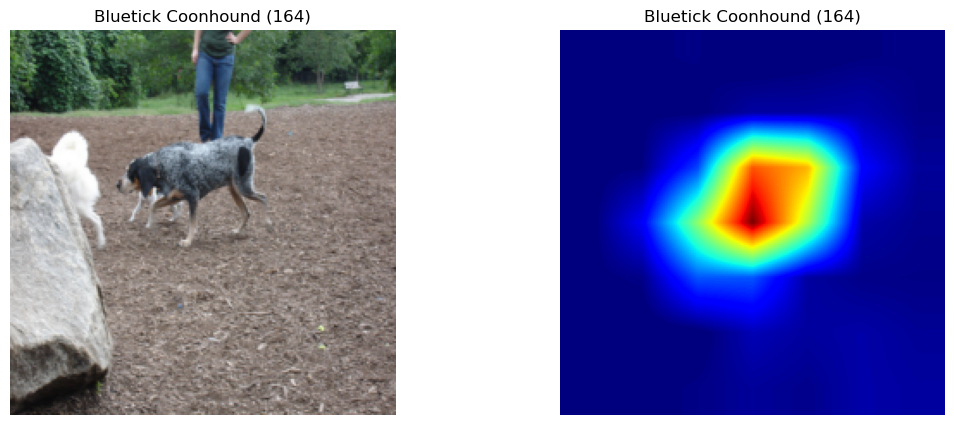

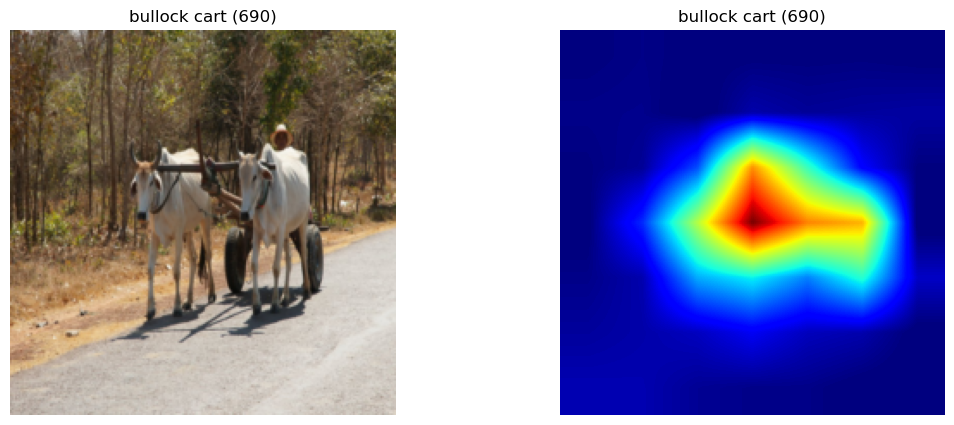

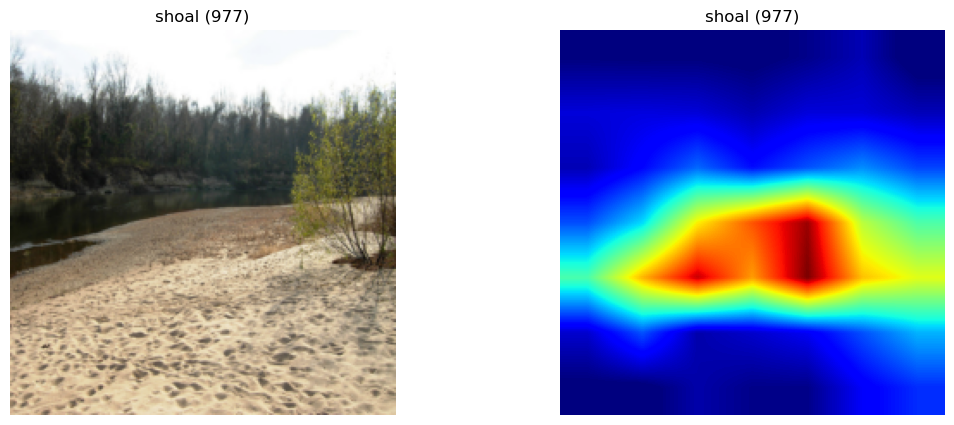

In [9]:
for X, y in dataloaders["validation"]:
    outputs = resnet(X).argmax(dim=1)
    for i, (img, label) in enumerate(zip(X, y)):
        x = torch.unsqueeze(img, 0)
        x = resnet.conv1(x)
        x = resnet.bn1(x)
        x = resnet.relu(x)
        x = resnet.maxpool(x)

        x = resnet.layer1(x)
        x = resnet.layer2(x)
        x = resnet.layer3(x)
        x = resnet.layer4(x)
        last_conv_feature_maps = x
        x = resnet.avgpool(x)
        x = torch.flatten(x, 1)
        x = resnet.fc(x)
        
        with torch.no_grad():
            pred = x.softmax(dim=1).argmax(dim=1).detach()
            
            x.grad = torch.zeros_like(x)
            x.grad[0][label] = 1.0 # TODO: try experimenting with values other than 1.0
        
        last_conv_feature_maps.retain_grad()
        x[0][label].backward()
        sigmas = torch.sum(last_conv_feature_maps.grad, dim=(2, 3))
        
        cam = np.sum([
            np.array(val * A, dtype=np.float32)
            for val, A in 
            zip(last_conv_feature_maps[0].clone().detach(), sigmas[0].clone().detach())
        ], axis=0)
    
        img[0] = img[0] * std[0] + mean[0]
        img[1] = img[1] * std[1] + mean[1]
        img[2] = img[2] * std[2] + mean[2]
        
        img = np.moveaxis(np.array(img), 0, -1)
        cam = cv2.resize(cam, img.shape[:2], interpolation=cv2.INTER_LINEAR)
        cam = np.maximum(cam, np.zeros_like(cam)) / cam.max()
        
        cmap = plt.get_cmap('jet')
        fig, ax = plt.subplots(1, 2, figsize=(13, 5))
        ax[0].imshow(img)
        ax[1].imshow(cam, cmap=cmap)
        ax[0].set_title(f"{class_names[label.item()]} ({label.item()})")
        ax[1].set_title(f"{class_names[pred.item()]} ({pred.item()})")
        ax[0].axis("off")
        ax[1].axis("off")
        plt.show()

    break

In [10]:
def insertion_score(original_image, cam_map, target_class):
    # 计算插入得分的逻辑
    # 在原图上叠加CAM并评估输出
    heatmap = cv2.applyColorMap(np.uint8(255 * cam_map), cv2.COLORMAP_JET)
    blended = cv2.addWeighted(original_image, 0.5, heatmap, 0.5, 0)
    # 重新预测
    inputs = transform(blended).unsqueeze(0).to(device)
    outputs = model(inputs)
    pred = outputs.argmax(dim=1).item()
    
    return pred == target_class  # 返回布尔值

def deletion_score(original_image, cam_map, target_class):
    # 计算删除得分的逻辑
    # 将CAM区域置为0，然后重新预测
    heatmap = np.uint8(255 * cam_map)
    masked_image = original_image.cpu().numpy().copy()
    masked_image[heatmap > 0] = 0  # 将CAM区域置为黑色
    # 重新预测
    inputs = transform(masked_image).unsqueeze(0).to(device)
    outputs = model(inputs)
    pred = outputs.argmax(dim=1).item()
    
    return pred == target_class  # 返回布尔值

def difference_score(original_image, cam_map, target_class):
    # 计算差异得分的逻辑
    # 计算原始预测与CAM注入后的预测的差异
    outputs_original = model(original_image.unsqueeze(0).to(device))
    pred_original = outputs_original.argmax(dim=1).item()

    heatmap = np.uint8(255 * cam_map)
    blended = cv2.addWeighted(original_image.cpu().numpy(), 0.5, heatmap, 0.5, 0)
    inputs = transform(blended).unsqueeze(0).to(device)
    outputs_blended = model(inputs)
    pred_blended = outputs_blended.argmax(dim=1).item()

    return pred_original, pred_blended 

In [12]:
def generate_gradcam(model, dataloaders, class_names, mean, std):
    model.eval()
    
    for X, y in dataloaders["validation"]:
        outputs = model(X).argmax(dim=1)
       
    print(f"Outputs shape: {outputs.shape}")

  
    if outputs.dim() == 1: 
        outputs = outputs.unsqueeze(1) 

        for i, (img, label) in enumerate(zip(X, y)):
            x = torch.unsqueeze(img, 0)
            # Forward hook to get activations
            last_conv_feature_maps = model.layer4(model.layer3(model.layer2(model.layer1(
                model.bn1(model.conv1(x)))))
            )

            # Zero gradients for the output
            model.zero_grad()
            pred = outputs[i].item()
            one_hot_output = torch.zeros((1, outputs.size(1)), dtype=torch.float32).to(X.device)
            one_hot_output[0][label] = 1.0

            # Backward pass
            last_conv_feature_maps.retain_grad()
            model.fc(x.view(x.size(0), -1)).backward(gradient=one_hot_output)

            # Compute Grad-CAM
            grad_cam_weights = last_conv_feature_maps.grad.squeeze().detach().cpu().numpy()
            cam = np.zeros(last_conv_feature_maps.shape[2:], dtype=np.float32)

            # Weighted sum of feature maps
            for j in range(grad_cam_weights.shape[0]):
                cam += grad_cam_weights[j] * last_conv_feature_maps[0][j].detach().cpu().numpy()

            # Apply ReLU
            cam = np.maximum(cam, 0)

            # Normalize the CAM
            cam = cam - np.min(cam)
            if np.max(cam) != 0:  # Avoid division by zero
                cam = cam / np.max(cam)

            # Resize CAM to match the input image
            cam = cv2.resize(cam, (img.shape[1], img.shape[2]), interpolation=cv2.INTER_LINEAR)

            # De-normalize the image
            img = img.permute(1, 2, 0).cpu().numpy()
            img = img * std + mean
            img = np.clip(img, 0, 1)  # Ensure values are between 0 and 1

            # Plotting
            cmap = plt.get_cmap('jet')
            heatmap = cmap(cam)[:, :, :3]  # Get RGB from colormap
            overlay = heatmap + img  # Overlay heatmap on image
            overlay = overlay / np.max(overlay)  # Normalize overlay

            fig, ax = plt.subplots(1, 3, figsize=(15, 5))
            ax[0].imshow(img)
            ax[0].set_title(f"Original Image: {class_names[label.item()]} ({label.item()})")
            ax[1].imshow(cam, cmap='jet')
            ax[1].set_title(f"Grad-CAM")
            ax[2].imshow(overlay)
            ax[2].set_title(f"Overlay")
            for a in ax:
                a.axis("off")
            plt.show()

In [ ]:

last_conv = resnet.layer4[-1]
mean = [0.485, 0.456, 0.406] 
std = [0.229, 0.224, 0.225]  
for X, y in dataloaders["validation"]:
 
    X = X[0:1].to(device)  
    target_class = y[0].item() 

   
    cam_map = generate_gradcam(resnet,dataloaders, X,  mean, std) 

   
    visualize_gradcam(X, cam_map)  

    
    ins_score = insertion_score(X, cam_map, target_class)
    del_score = deletion_score(X, cam_map, target_class)
    orig_pred, blended_pred = difference_score(X, cam_map, target_class)

    print(f"Insertion Score: {ins_score}, Deletion Score: {del_score}, Original Prediction: {orig_pred}, Blended Prediction: {blended_pred}")
    break  